# Build KRC

## Import libraries

In [1]:
from packages import kuramoto as kr
from packages import kuramoto_nex as nkr
from packages import plotting

import numpy as np
import matplotlib.pyplot as plt
import networkx as nx
import seaborn as sns
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from tqdm import tqdm, trange
from sklearn.metrics import mean_squared_error


np.random.seed(42)

sns.set_style("whitegrid")
sns.set_context("notebook", font_scale=1.6)

## Define functions

In [2]:
def getReservoir(matrix, time_interval=10):
    sampled_matrix = matrix[:, ::time_interval]
    diff_matrix = np.diff(sampled_matrix, n=1, axis=1)
    reservoir_t = diff_matrix.flatten(order='K')
    #print(sampled_matrix.shape)
    #print(diff_matrix.shape)
    #print(reservoir_t.shape)

    return reservoir_t

In [3]:
def ridge_regression(trainRes, trainData, reg):
    ResSize = trainRes.shape[1]
    Wout = np.linalg.solve(np.dot(trainRes.T, trainRes) + reg*np.eye(ResSize), np.dot(trainRes.T, trainData))
    return Wout

In [4]:
def getNextPhase(matrix, model):
    act_mat = model.run(adj_mat=graph, angles_vec=matrix)
    phase = getLastPhase(matrix=act_mat)
    
    return phase

In [5]:
def getPerturbedPhase(t, input_data, index, phase):
    for (i,j) in enumerate(index):
        phase[j] += input_data[t, i]
    
    return phase

In [6]:
def getLastPhase(matrix):
    return matrix[:,-1]

## Define parameters

In [7]:
NODE = 100
graph_nx = nx.erdos_renyi_graph(n=NODE, p=1, seed=42) # p=1 -> all-to-all connectivity
graph = nx.to_numpy_array(graph_nx)

np.random.seed(42)
init_phase = 2 * np.pi * np.random.random(size=NODE)
natfreqs = np.random.normal(loc = 0, scale = 1, size = NODE)

## Find critical coupling

In [8]:
t = np.linspace(0, 4, 51)
order_ex = []
variance_ex = []

order_nex = []
variance_nex = []

for k in tqdm(t):
    model_ex = kr.Kuramoto(coupling=k, dt=0.01, T=10, n_nodes=len(graph), natfreqs=natfreqs)
    model_nex = nkr.Kuramoto(coupling=k, dt=0.01, T=10, n_nodes=len(graph), natfreqs=natfreqs)
    # Run simulation - output is time series for all nodes (node vs time)
    act_mat_ex = model_ex.run(adj_mat=graph, angles_vec = init_phase)
    act_mat_nex = model_nex.run(adj_mat=graph, angles_vec = init_phase)

    order_ex.append(model_ex.phase_coherence(act_mat_ex[:,-1]))
    variance_ex.append(model_ex.mean_frequency(act_mat_ex, graph))

    order_nex.append(model_nex.phase_coherence(act_mat_nex[:,-1]))
    variance_nex.append(model_nex.mean_frequency(act_mat_nex, graph))

# Create subplot figure with shared axes
fig = make_subplots(rows=1, cols=2, subplot_titles=["(a) Kuramoto Order Parameters", "(b) Variance Order Parameters"], horizontal_spacing=0.1, shared_xaxes=True)

# Add traces to subplot 1
fig.add_trace(
    go.Scatter(x=t, y=order_ex, mode='markers+lines', marker=dict(color='red', size=4), line=dict(width=0.8), name='Order Ex'),
    row=1, col=1
)
fig.add_trace(
    go.Scatter(x=t, y=order_nex, mode='markers+lines', marker=dict(color='black', size=4), line=dict(width=0.8), name='Order Nex'),
    row=1, col=1
)
fig.update_yaxes(title_text='$r$', range=[0,1], row=1, col=1)

# Add traces to subplot 2
fig.add_trace(
    go.Scatter(x=t, y=variance_ex, mode='markers+lines', marker=dict(color='red', size=4), line=dict(width=0.8), name='Variance Ex'),
    row=1, col=2
)
fig.add_trace(
    go.Scatter(x=t, y=variance_nex, mode='markers+lines', marker=dict(color='black', size=4), line=dict(width=0.8), name='Variance Nex'),
    row=1, col=2
)
fig.update_yaxes(title_text=r'$r_{var}$', range=[0,1], row=1, col=2)

# Update layout with synchronized hovermode
fig.update_layout(height=500, width=900, showlegend=False, title_text=f"Kuramoto and Variance Order Parameters (N={NODE})", title_x=0.5, hovermode='x unified')

fig.show()

100%|██████████| 51/51 [00:16<00:00,  3.14it/s]


# Run KRC

## Load data

Minimum value of rescaled data: -0.3
Maximum value of rescaled data: 0.3


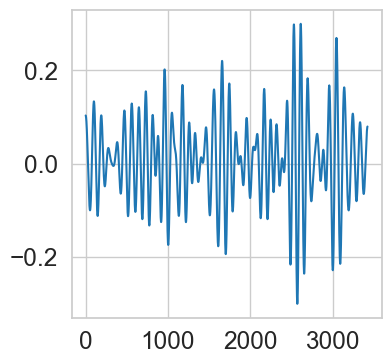

In [11]:
# Load data from file
data = np.loadtxt('data/ewt5.txt')
mean = 0
std = 0
noise = np.random.normal(mean, std, size=data.shape)
data+=noise
# Define the lower and upper bounds of the new range
a, b = 0.3,-0.3

# Rescale data into the range of a to b
data_scaled = (b - a) * (data - np.min(data)) / (np.max(data) - np.min(data)) + a

# Print the minimum and maximum values of the rescaled data
print('Minimum value of rescaled data:', np.min(data_scaled))
print('Maximum value of rescaled data:', np.max(data_scaled))

data = data_scaled
# resample
data = data[::100]
plt.figure(figsize=(4,4))
plt.plot(data)

## Train and Test KRC

In [12]:
def evaluate(critical_coupling=np.e, p=1):
    #critical_coupling = 2.7
    graph_nx = nx.erdos_renyi_graph(n=NODE, p=p, seed=42)
    graph = nx.to_numpy_array(graph_nx)
    hist = []

    input_interval = 1
    sample_interval=10*input_interval
    dt = 0.01

    ResSize = 2500
    push = 500
    trainLen = ResSize-push
    #x = np.linspace(0, 1000,10000)
    #data = np.sin(x)
    input_data = data.reshape(-1,1)
    trainData = input_data[push+1:push+trainLen+1,:]

    print('NODE:\t{}\nK:\t{}\ndt:\t{}\nT:\t{}'.format(NODE, critical_coupling, dt, input_interval))

    # Now we are ready to perturb data
    reservoir = []

    act_mat_hist = []

    critical_model = kr.Kuramoto(coupling=critical_coupling, dt=dt, T=10+dt, n_nodes=len(graph), natfreqs=natfreqs)
    act_mat = critical_model.run(adj_mat=graph, angles_vec = init_phase)
    synced_phases = act_mat[:,-1]

    model = kr.Kuramoto(coupling=critical_coupling, dt=dt, T=dt, n_nodes=NODE, natfreqs=natfreqs)
    synced_phases = getNextPhase(matrix=synced_phases, model=model)

    model = kr.Kuramoto(coupling=critical_coupling, dt=dt, T=input_interval+dt, n_nodes=NODE, natfreqs=natfreqs)

    for t in trange(0, ResSize):
        perturbed_phases = getPerturbedPhase(t, input_data=input_data, index=[0], phase=synced_phases)
        act_mat = model.run(adj_mat=graph, angles_vec=perturbed_phases)
        
        reservoir.append(getReservoir(matrix=act_mat, time_interval=sample_interval))
        synced_phases = getLastPhase(matrix=act_mat)

        act_mat_hist.append(act_mat)
    print(np.array(reservoir).shape)
    reservoir_T = np.vstack(reservoir)
    trainRes = reservoir_T[push:push+trainLen,:]

    reg = 1e-9 # regularization coefficient
    Wout = ridge_regression(trainRes, trainData, reg)

    testLen = 800
    testData = input_data[push+trainLen+1:push+trainLen+1+testLen,:]

    target = trainData[-1,:].reshape(-1,1)

    pred = []

    model = kr.Kuramoto(coupling=critical_coupling, dt=dt, T=dt, n_nodes=NODE, natfreqs=natfreqs)
    synced_phases = getNextPhase(matrix=synced_phases, model=model)

    model = kr.Kuramoto(coupling=critical_coupling, dt=dt, T=input_interval+dt, n_nodes=NODE, natfreqs=natfreqs)

    for t in trange(0, testLen):
        for (i,j) in enumerate([0]):
            synced_phases[j] += target[i]
            
        act_mat = model.run(adj_mat=graph, angles_vec = synced_phases)
        act_mat_sampled = act_mat[:, ::sample_interval]
        act_mat_diff = np.diff(act_mat_sampled, n=1, axis=1)
        reservoir_t = act_mat_diff.flatten(order='K')
        pred.append(np.matmul(reservoir_t, Wout))

        synced_phases = getLastPhase(matrix=act_mat)
        target = pred[-1]
        
    pred = np.vstack(pred)
    RMSE = mean_squared_error(testData, pred)**0.5
    print(RMSE)
    
    #plt.plot(pred)
    return pred, testData, act_mat_hist, RMSE


In [13]:
pred, testData, act_mat_hist, RMSE = evaluate(2.8, 1)

NODE:	100
K:	2.8
dt:	0.01
T:	1


100%|██████████| 2500/2500 [00:08<00:00, 292.58it/s]


(2500, 1000)


100%|██████████| 800/800 [00:03<00:00, 241.90it/s]

2.7648113269093875


## Show results

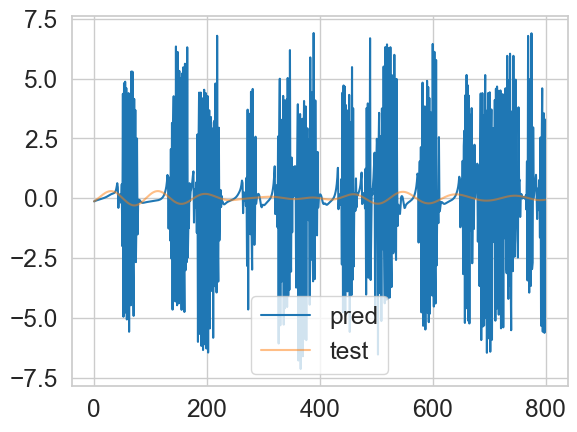

In [14]:
plt.plot(pred, label='pred')
plt.plot(testData, label='test', alpha=0.5)
plt.legend()

In [15]:
#np.savetxt('data/ewt1_pred.txt', pred)
#np.savetxt('data/ewt1_test.txt', testData)

In [16]:
act_mat_hist = np.hstack(act_mat_hist)

## Plot activity matrix to check synchronization

In [17]:
plotting.plot_activity(act_mat_hist[:,0:5000])

## Plot coupling versus error

In [17]:
error_mat = []
for k in np.linspace(2, 4, 11):
    error_mat.append(evaluate(k, 1))

NODE:	100
K:	2.0
dt:	0.01
T:	1


100%|██████████| 1000/1000 [00:03<00:00, 310.74it/s]


0.2936631842718907
NODE:	100
K:	2.2
dt:	0.01
T:	1


100%|██████████| 1000/1000 [00:14<00:00, 70.33it/s]


1.1531441121060662
NODE:	100
K:	2.4
dt:	0.01
T:	1


100%|██████████| 1000/1000 [00:13<00:00, 74.29it/s]


0.19765107992641737
NODE:	100
K:	2.6
dt:	0.01
T:	1


100%|██████████| 1000/1000 [00:04<00:00, 209.45it/s]


0.15273037753981494
NODE:	100
K:	2.8
dt:	0.01
T:	1


100%|██████████| 1000/1000 [00:05<00:00, 171.87it/s]


0.13997224670522154
NODE:	100
K:	3.0
dt:	0.01
T:	1


100%|██████████| 1000/1000 [00:05<00:00, 173.33it/s]


0.12069628236057553
NODE:	100
K:	3.2
dt:	0.01
T:	1


100%|██████████| 1000/1000 [00:06<00:00, 156.08it/s]


0.281996564441534
NODE:	100
K:	3.4000000000000004
dt:	0.01
T:	1


100%|██████████| 1000/1000 [00:07<00:00, 140.84it/s]


0.29653557356153787
NODE:	100
K:	3.6
dt:	0.01
T:	1


100%|██████████| 1000/1000 [00:08<00:00, 114.47it/s]


0.2702579783998166
NODE:	100
K:	3.8
dt:	0.01
T:	1


100%|██████████| 1000/1000 [00:10<00:00, 99.11it/s]


0.2418312341319876
NODE:	100
K:	4.0
dt:	0.01
T:	1


100%|██████████| 1000/1000 [00:11<00:00, 84.07it/s]

0.2201804728818244


In [19]:
error_mat = np.array(error_mat)

C:\Users\aqhac\AppData\Local\Temp\ipykernel_14372\273939247.py:1: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.



In [22]:
# Generate sample data
x = np.linspace(2, 4, 11)
y = error_mat[:,-1]

# Find minimum value and index
min_idx = np.argmin(y)
min_val = y[min_idx]

# Create plotly trace
trace = go.Scatter(x=x, y=y, mode='lines+markers')

# Add minimum value marker
marker = go.scatter.Marker(color='red', size=10)
min_trace = go.Scatter(x=[x[min_idx]], y=[min_val], mode='markers', marker=marker)

# Create layout
layout = go.Layout(title='Kuramoto Model', xaxis_title='Coupling Strength', yaxis_title='Error on Test Set')

# Combine trace and layout into a figure
fig = go.Figure(data=[trace, min_trace], layout=layout)

# Display the figure
fig.show()

In [42]:
error_mat = []

for mean_degree in np.arange(5, 51, 5):
    p = (2 * mean_degree) / (NODE - 1)
    error_mat.append(evaluate(2.7, p)[:-1])

NODE:	100
K:	2.7
dt:	0.01
T:	1


100%|██████████| 1000/1000 [00:51<00:00, 19.44it/s]


0.3018859537569407
NODE:	100
K:	2.7
dt:	0.01
T:	1


100%|██████████| 1000/1000 [00:57<00:00, 17.46it/s]


0.3273988680475771
NODE:	100
K:	2.7
dt:	0.01
T:	1


100%|██████████| 1000/1000 [00:35<00:00, 28.37it/s]


0.33145756276599686
NODE:	100
K:	2.7
dt:	0.01
T:	1


100%|██████████| 1000/1000 [00:38<00:00, 25.96it/s]


0.30742243264389507
NODE:	100
K:	2.7
dt:	0.01
T:	1


100%|██████████| 1000/1000 [00:40<00:00, 24.99it/s]


0.3310002838448237
NODE:	100
K:	2.7
dt:	0.01
T:	1


100%|██████████| 1000/1000 [00:50<00:00, 19.95it/s]


0.27170614079868843
NODE:	100
K:	2.7
dt:	0.01
T:	1


100%|██████████| 1000/1000 [00:41<00:00, 24.20it/s]


0.26136073298358753
NODE:	100
K:	2.7
dt:	0.01
T:	1


100%|██████████| 1000/1000 [00:59<00:00, 16.75it/s]


0.26539156988816814
NODE:	100
K:	2.7
dt:	0.01
T:	1


100%|██████████| 1000/1000 [01:02<00:00, 15.99it/s]


0.24395721422291625
NODE:	100
K:	2.7
dt:	0.01
T:	1


100%|██████████| 1000/1000 [00:39<00:00, 25.51it/s]

0.19331438712507787
